# **Mushrooms Classification**

## ***Introduction***

### ***Objective:***
The goal of this project is to classify images of mushrooms into different genera using deep learning. This classification task has potential applications in:
- Identifying edible vs. poisonous mushrooms to ensure public safety.
- Assisting mycologists in automating the identification process.
- Supporting educational tools for learning about fungal biodiversity.

---

## ***Steps Overview***

1. **Exploratory Data Analysis (EDA)**:
   - Understand the dataset and inspect class distributions.
   - Analyze image dimensions across different classes.

2. **Data Preprocessing**:
   - Load images, handle corrupted data, and split the dataset into training, validation, and test sets.
   - Apply augmentations to improve generalization.

3. **Model Architecture**:
   - Use a pre-trained ResNet-18 as the backbone and fine-tune it for mushroom classification.

4. **Training the Model**:
   - Train the model using PyTorch Lightning with class imbalance handling, learning rate scheduling, and gradient clipping.

5. **Evaluation**:
   - Evaluate the model on the test set using classification metrics and confusion matrix.
   - Measure inference time and analyze training curves (loss, accuracy).



In [ ]:
import cv2
import hashlib
import kagglehub
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import pytorch_lightning as pl
import random
import seaborn as sns
import sklearn
import time
import torch

from dask import bag
from dask.diagnostics import ProgressBar
from PIL import Image, ImageStat
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import EarlyStopping, ModelCheckpoint
from pytorch_lightning.loggers import CSVLogger
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from torch import nn
from torch.nn import functional as F
from torch.optim import Adam
from torch.optim.lr_scheduler import LambdaLR, ReduceLROnPlateau, OneCycleLR
from torch.utils.data import DataLoader, Dataset, Subset
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.models import resnet18, ResNet18_Weights
from torchmetrics import F1Score
from torchmetrics.classification import Accuracy, MulticlassAccuracy
from tqdm import tqdm


We will download dataset straight from Kaggle

In [2]:
# path = kagglehub.dataset_download("maysee/mushrooms-classification-common-genuss-images")
path = "C:/Users/iceke/.cache/kagglehub/datasets/maysee/mushrooms-classification-common-genuss-images/versions/1"

In [3]:
dataset_dir = f'{path}/mushrooms'
classes = os.listdir(dataset_dir)
SEED = 37

We save path to the file and label into a dataframe

In [4]:
records = []

for cls in classes:
    class_dir = os.path.join(dataset_dir, cls)
    for fname in os.listdir(class_dir):
        file_path = os.path.join(class_dir, fname)
        if os.path.isfile(file_path):
            records.append({
                "image_path": file_path,
                "class": cls
            })

mushrooms_df = pd.DataFrame(records)
print(f"Total images found: {len(mushrooms_df)}")

Total images found: 6717


## ***1. Exploratory Data Analysis***

### ***Class Distribution***

We will display the count of images for each class in the dataset. This will be useful to evaluate the possibility of class imbalance.

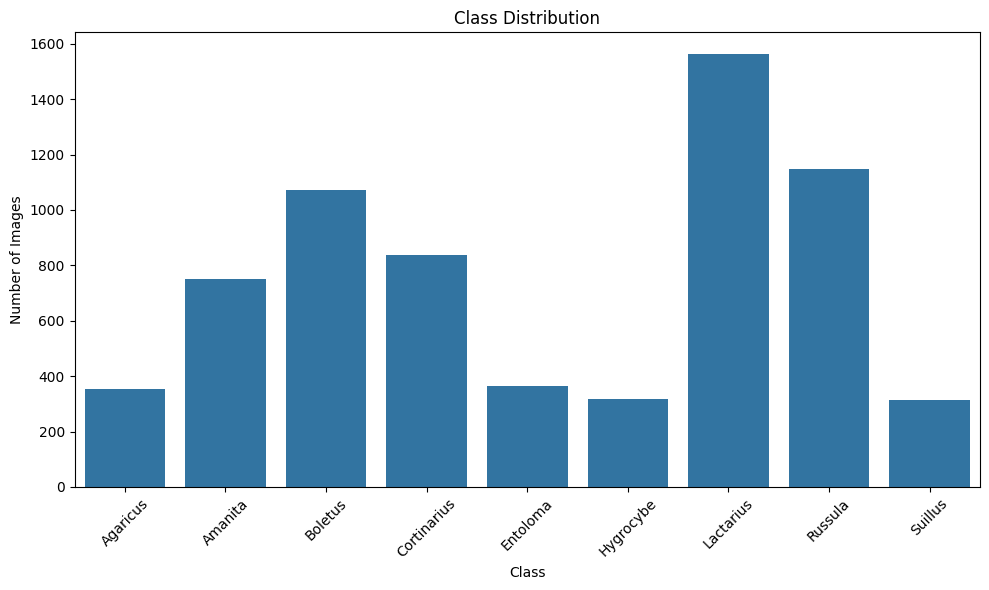

In [24]:
class_counts = mushrooms_df["class"].value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=class_counts.index, y=class_counts.values)
plt.title("Class Distribution")
plt.xlabel("Class")
plt.ylabel("Number of Images")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


As we can notice, some classes are more represented than others. Here below a brief description of the classes:

1. **Agaricus**:
   - **Edibility**: Mixed (includes both edible and toxic species).
   - **Examples**: Edible species like Agaricus bisporus (button mushroom) and toxic species like Agaricus xanthodermus.

2. **Amanita**:
   - **Edibility**: Mostly toxic, with some deadly poisonous species.
   - **Examples**: Amanita phalloides (death cap) and Amanita muscaria (fly agaric, toxic but used in traditional medicine).

3. **Boletus**:
   - **Edibility**: Mixed (mostly edible but some inedible or mildly toxic species).
   - **Examples**: Edible species like Boletus edulis (porcini) and mildly toxic species like Boletus satanas (Satan's bolete).

4. **Cortinarius**:
   - **Edibility**: Mostly inedible or toxic.
   - **Examples**: Some species contain dangerous toxins, e.g., Cortinarius orellanus (deadly webcap).

5. **Entoloma**:
   - **Edibility**: Mostly inedible or toxic.
   - **Examples**: Entoloma sinuatum (toxic) is a well-known example.

6. **Hygrocybe**:
   - **Edibility**: Mostly inedible.
   - **Examples**: Known for their bright colors but rarely consumed.

7. **Lactarius**:
   - **Edibility**: Mixed (some species are edible, others mildly toxic).
   - **Examples**: Edible species like Lactarius deliciosus (saffron milk cap).

8. **Russula**:
   - **Edibility**: Mixed (some edible, many inedible or mildly toxic).
   - **Examples**: Edible species like Russula cyanoxantha (charcoal burner).

9. **Suillus**:
   - **Edibility**: Mostly edible.
   - **Examples**: Suillus luteus (slippery jack) is widely consumed.


### ***Visual Samples for Each Class***

We will visually inspect some samples from each class to spot similarity and differences that maybe useful during the definition of a data preprocessor.

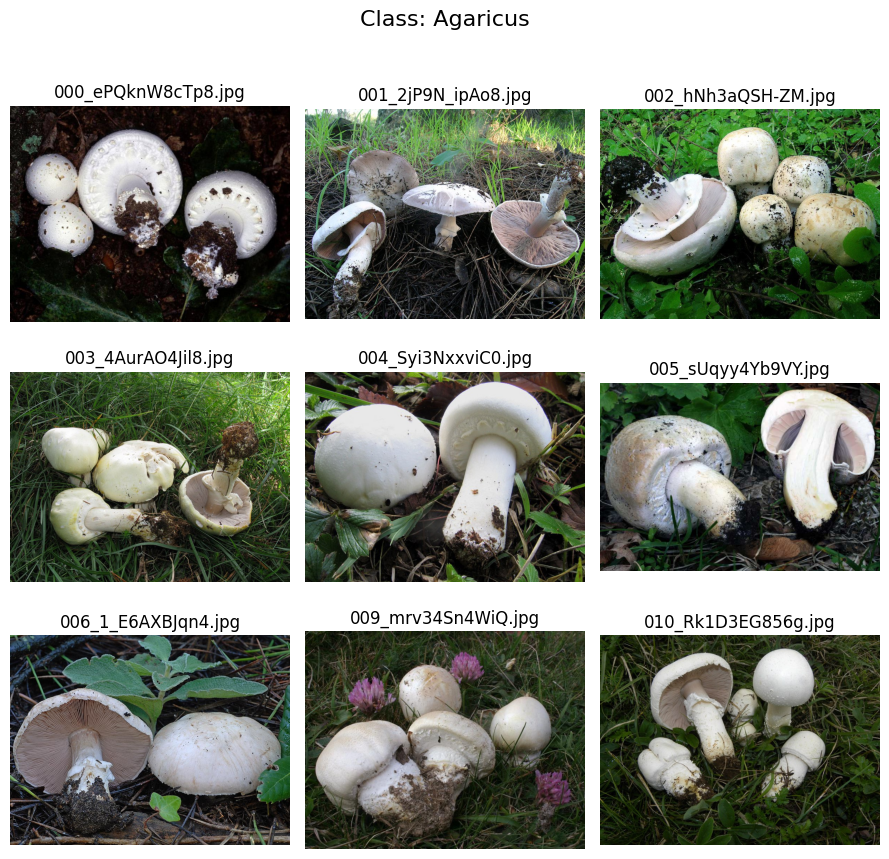

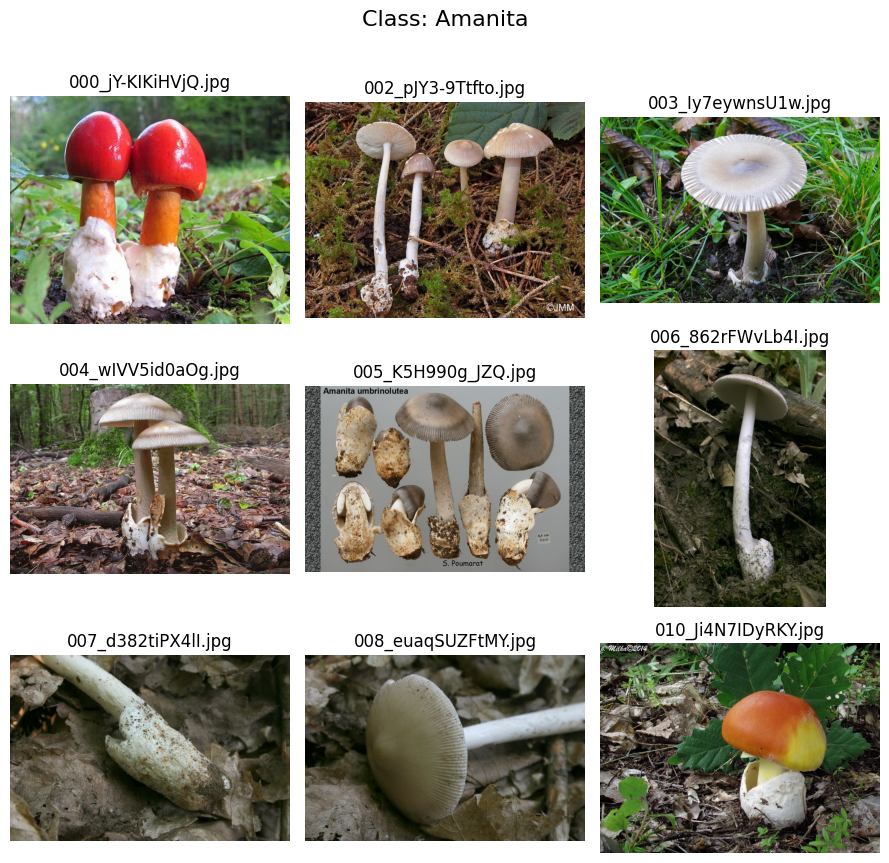

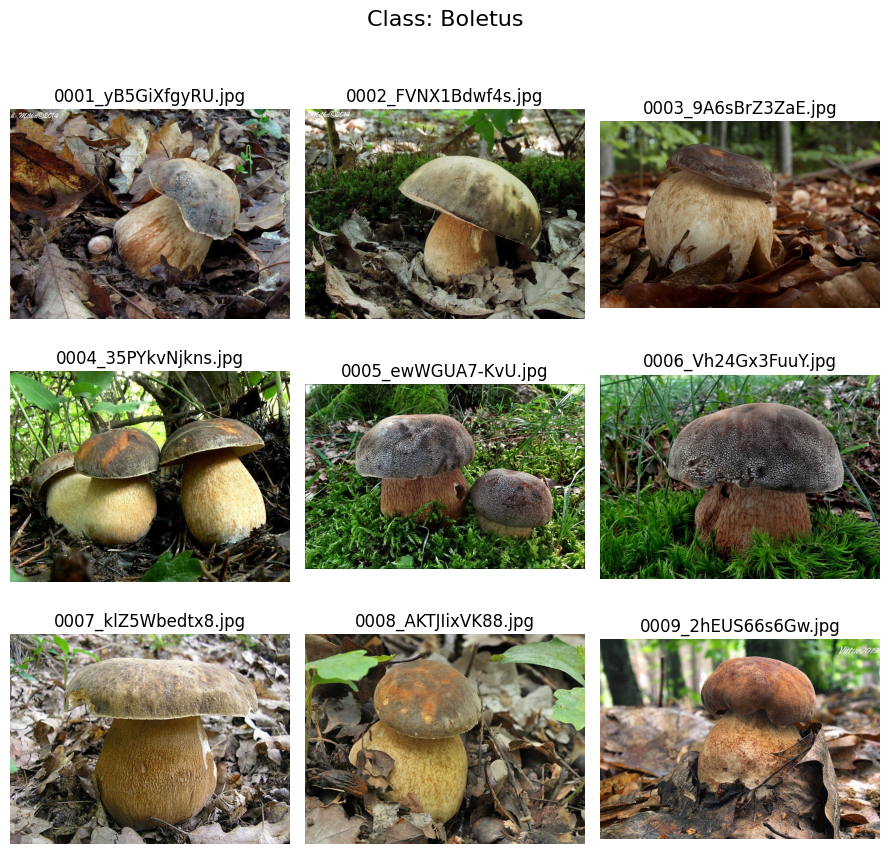

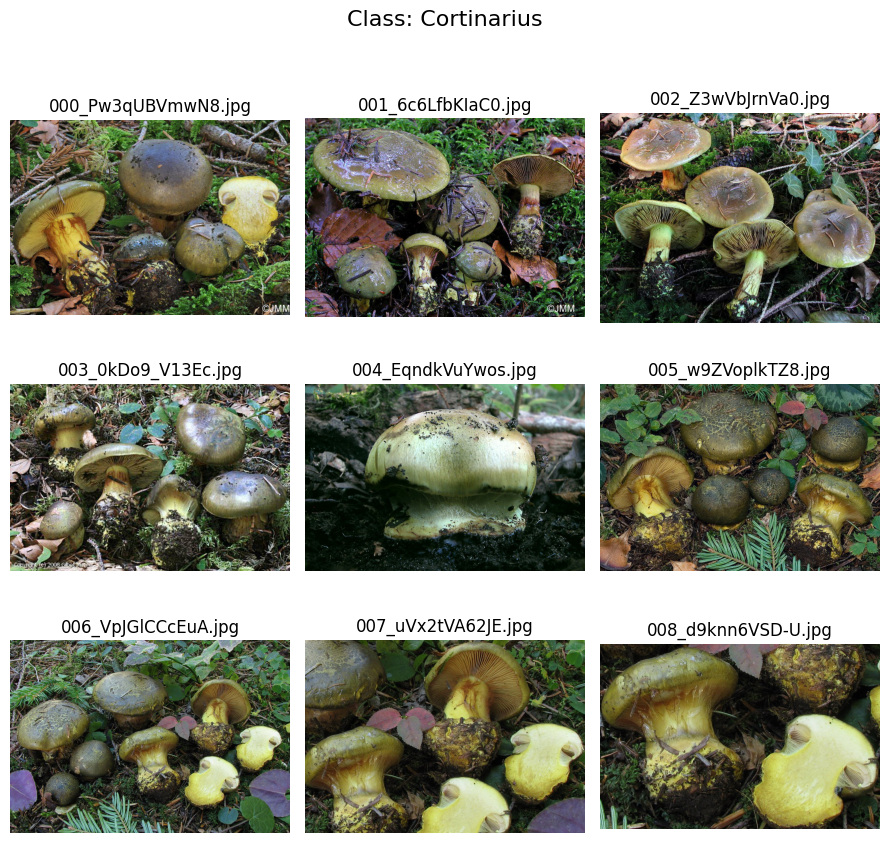

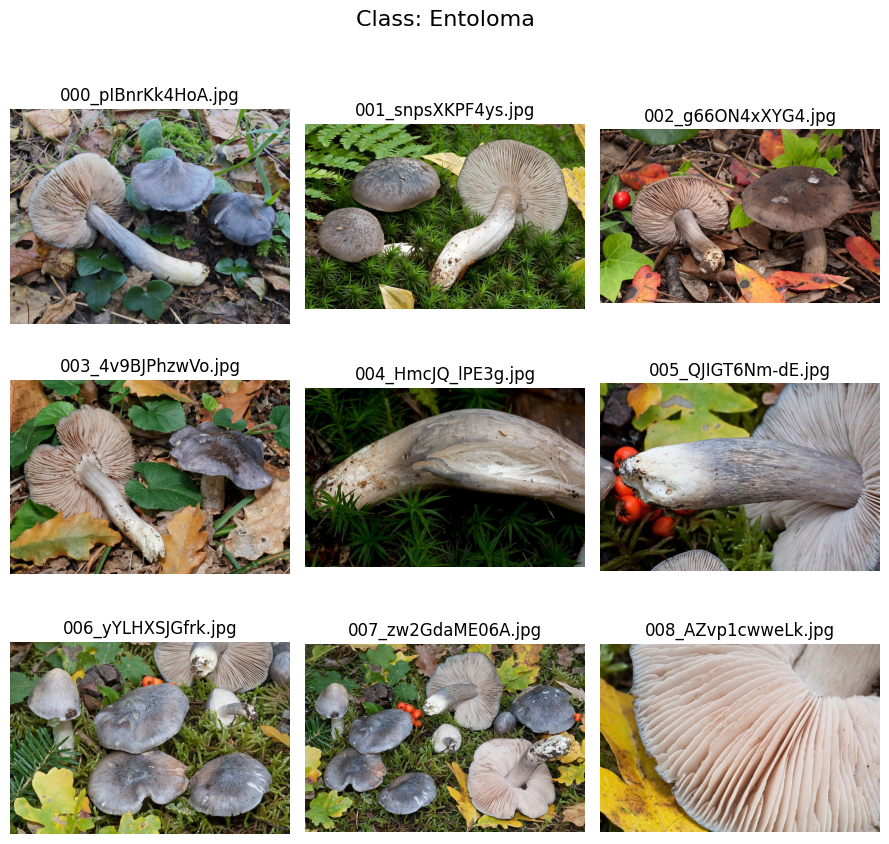

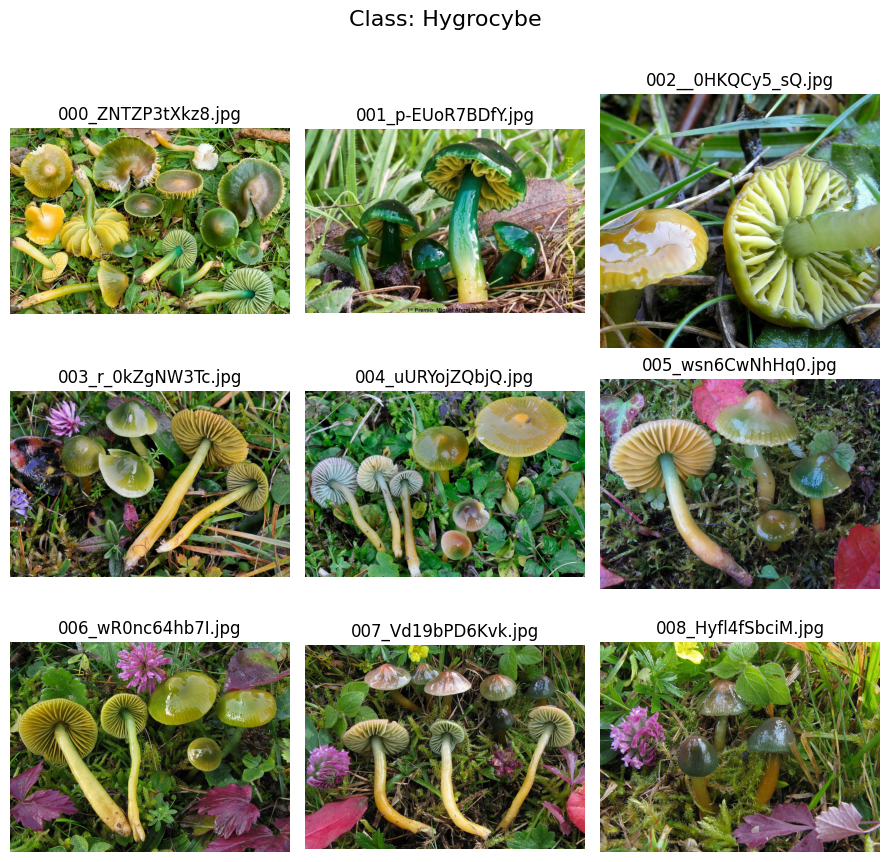

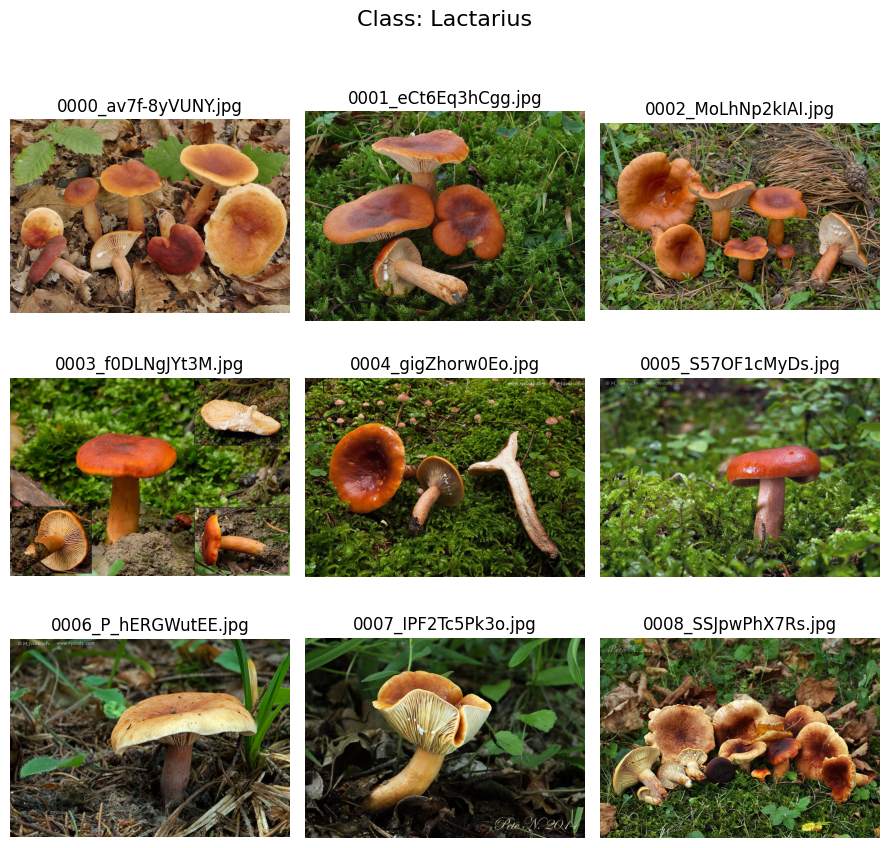

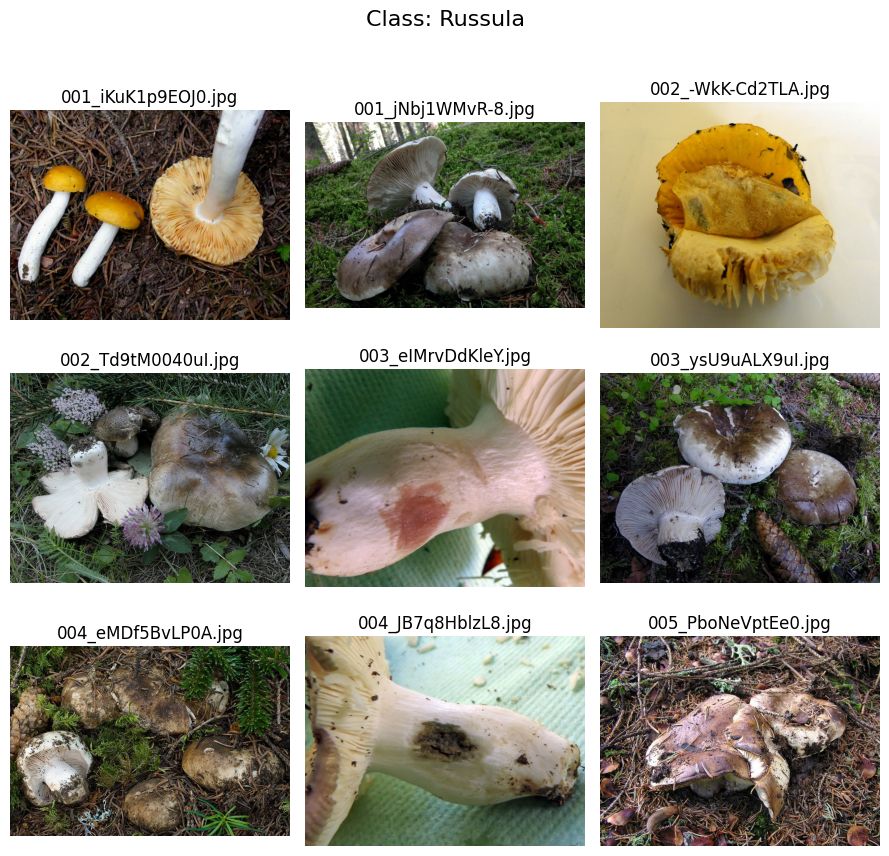

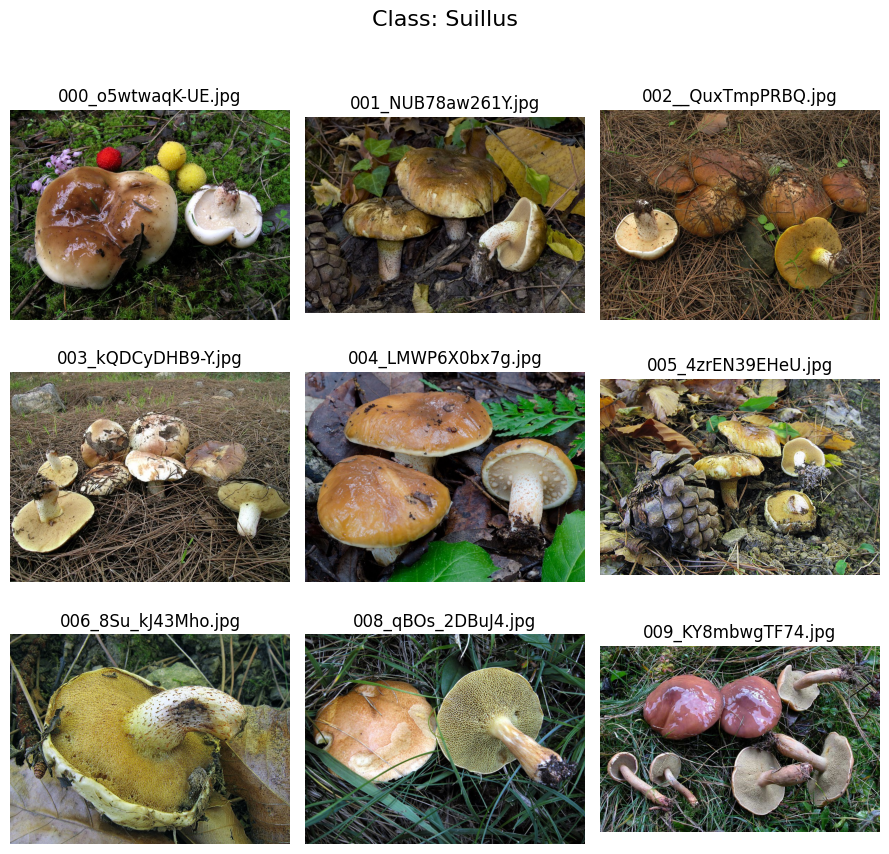

In [ ]:
def display_samples_per_class(df, classes, samples_per_class=9, grid_rows=3, grid_cols=3):
    """
    Display a grid of sample images for each class to visually inspect for mislabels or outliers.
    
    Args:
        df (DataFrame): The mushrooms DataFrame containing 'image_path' and 'class'.
        classes (list): List of class names to display.
        samples_per_class (int): Number of images to show per class.
        grid_rows (int): Rows in the image grid.
        grid_cols (int): Columns in the image grid.
    """
    for cls in classes:
        sample_paths = df[df["class"] == cls]["image_path"].head(samples_per_class).tolist()

        fig, axes = plt.subplots(grid_rows, grid_cols, figsize=(grid_cols * 3, grid_rows * 3))
        fig.suptitle(f"Class: {cls}", fontsize=16)
        axes = axes.flatten()

        for i, img_path in enumerate(sample_paths):
            img = Image.open(img_path)
            axes[i].imshow(img)
            axes[i].set_title(os.path.basename(img_path))
            axes[i].axis('off')

        for j in range(len(sample_paths), len(axes)):
            axes[j].axis('off')

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()

# Call the function using the enriched DataFrame
display_samples_per_class(df=mushrooms_df, classes=classes)


### ***Image Properties***

We will now extract some properties from each image, size, brightness, saturation, hue, sharpness, to examine possible candidates to be pruned from the dataset.

In [5]:
def get_image_properties(image_path):
    try:
        image = Image.open(image_path).convert("RGB")
        image_cv = np.array(image)
        width, height = image.size

        # Brightness
        brightness = np.array(ImageStat.Stat(image).mean).mean()

        # HSV properties
        hsv_image = cv2.cvtColor(image_cv, cv2.COLOR_RGB2HSV)
        hue = hsv_image[:, :, 0].mean()
        saturation = hsv_image[:, :, 1].mean()

        # Sharpness
        gray_image = cv2.cvtColor(image_cv, cv2.COLOR_RGB2GRAY)
        sharpness = cv2.Laplacian(gray_image, cv2.CV_64F).var()

        return {
            "image_path": image_path,
            "width": width,
            "height": height,
            "brightness": brightness,
            "hue": hue,
            "saturation": saturation,
            "sharpness": sharpness
        }
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return {
            "image_path": image_path,
            "width": np.nan,
            "height": np.nan,
            "brightness": np.nan,
            "hue": np.nan,
            "saturation": np.nan,
            "sharpness": np.nan
        }

In [6]:
properties = [get_image_properties(p) for p in tqdm(mushrooms_df["image_path"], desc="Extracting image properties")]
props_df = pd.DataFrame(properties)
mushrooms_df = mushrooms_df.merge(props_df, on="image_path", how="left")

Extracting image properties:  81%|████████  | 5414/6717 [02:19<00:30, 42.66it/s]

Error processing C:/Users/iceke/.cache/kagglehub/datasets/maysee/mushrooms-classification-common-genuss-images/versions/1/mushrooms\Russula\092_43B354vYxm8.jpg: image file is truncated (92 bytes not processed)


Extracting image properties: 100%|██████████| 6717/6717 [02:53<00:00, 38.74it/s]


### ***Image Size Distribution***

We will now display the distribution of image sizes by class.

[########################################] | 100% Completed | 5.24 ss


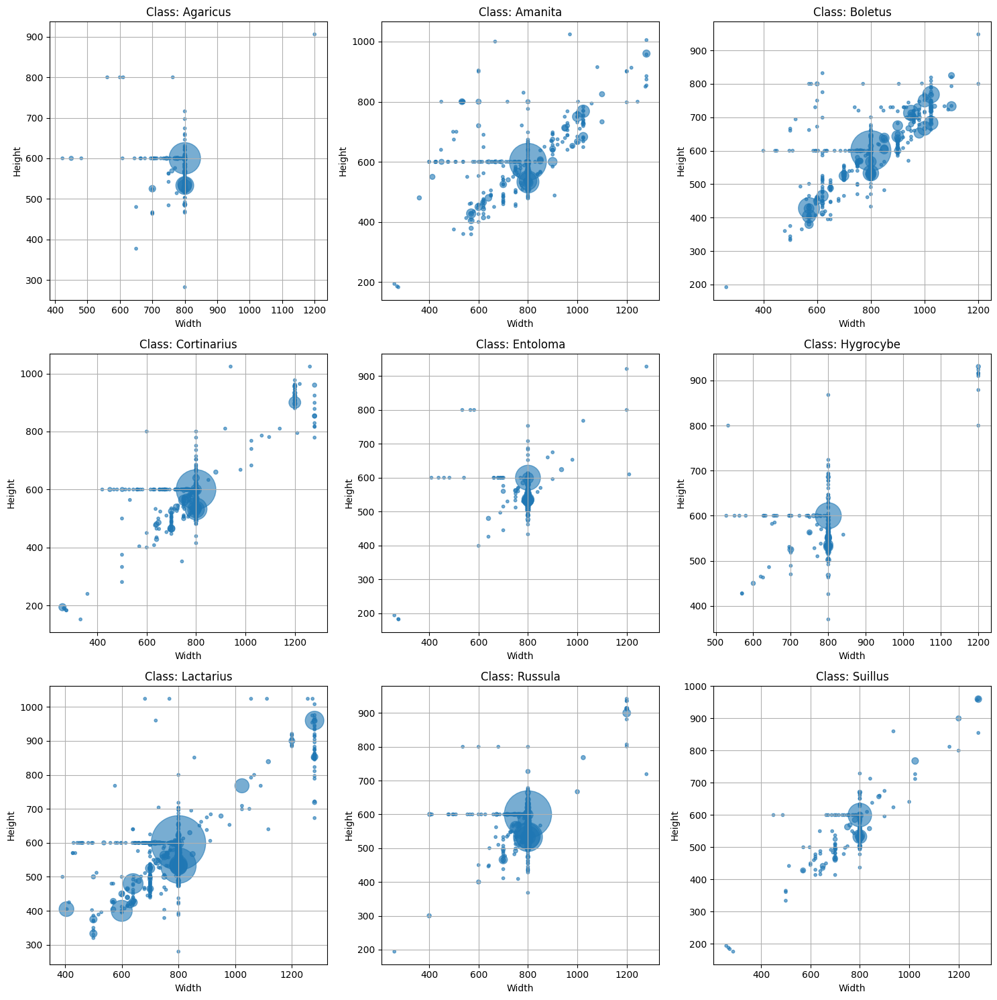

In [ ]:
num_classes = len(classes)
nrows, ncols = 3, 3
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 15))
axes = axes.flatten()

for i, class_name in enumerate(classes):
    class_data = mushrooms_df[mushrooms_df["class"] == class_name]
    grouped = class_data.groupby(["width", "height"]).size().reset_index(name="count")

    ax = axes[i]
    ax.scatter(grouped["width"], grouped["height"], s=grouped["count"] * 10, alpha=0.6)
    ax.set_title(f"Class: {class_name}")
    ax.set_xlabel("Width")
    ax.set_ylabel("Height")
    ax.grid(True)

# Hide unused plots
for j in range(len(classes), len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()

### ***Images Duplicates***

We tryto detect and remove duplicates to prevent bias in training and ensure cleaner data.

In [7]:
def compute_exact_hash(image_path):
    """Compute MD5 hash for an image to detect exact duplicates."""
    with open(image_path, "rb") as f:
        return hashlib.md5(f.read()).hexdigest()

hashes = []
for path in tqdm(mushrooms_df["image_path"], desc="Computing exact image hashes"):
    try:
        img_hash = compute_exact_hash(path)
    except Exception as e:
        print(f"Error hashing {path}: {e}")
        img_hash = None
    hashes.append(img_hash)

mushrooms_df["md5_hash"] = hashes
duplicate_counts = mushrooms_df["md5_hash"].value_counts()
duplicate_hashes = duplicate_counts[duplicate_counts > 1].index

mushrooms_df["exact_duplicate"] = mushrooms_df["md5_hash"].isin(duplicate_hashes)

Computing exact image hashes: 100%|██████████| 6717/6717 [00:04<00:00, 1573.30it/s]


In [ ]:
print(f"Found {mushrooms_df['exact_duplicate'].sum()} exact duplicate images.")

Found 140 exact duplicate images.


### ***Properties Distribution***

We will inspect boxplot of the main image properties to check if any extrem value should be addressed.

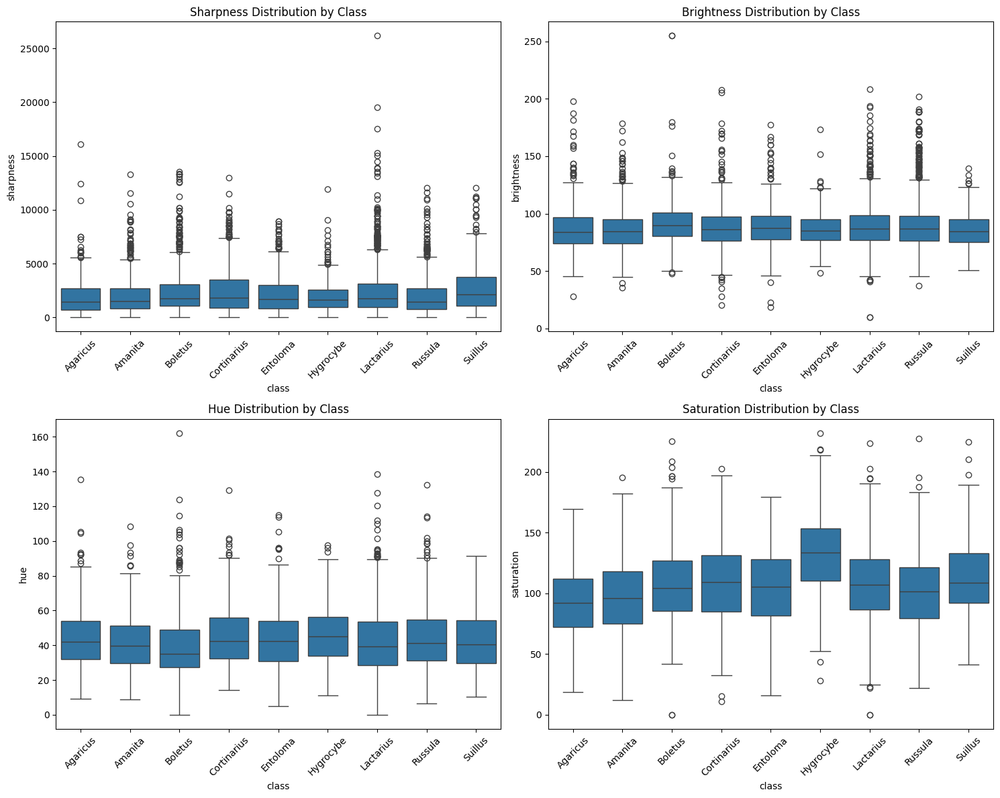

In [ ]:
quality_metrics = ["sharpness", "brightness", "hue", "saturation"]

fig, axes = plt.subplots(2, 2, figsize=(15, 12))
axes = axes.flatten()

for ax, metric in zip(axes, quality_metrics):
    sns.boxplot(x="class", y=metric, data=mushrooms_df, ax=ax)
    ax.set_title(f"{metric.capitalize()} Distribution by Class")
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

From the top-left plot (Sharpness), we see a fairly wide distribution across all classes, indicating that images vary considerably in focus and clarity. Some classes, such as Amanita and Hygrocybe, show more high-end outliers, which may reflect better camera focus or post-processing on certain images. Overall, there are no classes with extremely low median sharpness, but the presence of many outliers suggests the dataset contains a mix of very sharp and moderately blurry images.

Looking at the top-right plot (Brightness), the medians are relatively close, with Hygrocybe and Russula possibly trending a bit brighter on average, while Entoloma appears slightly darker. These differences might be explained by the lighting conditions or the inherent coloration of the mushrooms themselves.

In the bottom-left plot (Hue), most classes overlap heavily, though Amanita has a slightly higher median hue and Cortinarius a bit lower. Because hue in the HSV space is cyclical, the overlap could mean many images share similar color tones, which might make color alone insufficient to distinguish classes reliably.

Finally, the bottom-right plot (Saturation) also shows broad overlap. Suillus has quite a large spread, indicating that some images are deeply saturated while others are more washed out. Meanwhile, Entoloma appears somewhat less varied. These differences could reflect not only the natural color diversity of mushrooms but also variations in photography conditions (e.g., camera settings or ambient light).

Overall, these box plots confirm that each class has a wide range of image qualities and color characteristics, with some noticeable class-specific trends. Such variability emphasizes the importance of robust data preprocessing and augmentations to help the model generalize better.

In [35]:
def show_images_by_metric(df, metric, title, n=10, rows=2, cols=5, mode="lowest"):
    """
    Show n images with either the lowest or highest values for a given image property
    in a grid layout.

    Parameters:
        df (pd.DataFrame): DataFrame with image info
        metric (str): column name for metric (e.g., 'brightness', 'sharpness')
        title (str): plot title
        n (int): number of images to display
        rows (int): number of grid rows
        cols (int): number of grid columns
        mode (str): 'lowest' or 'highest'
    """
    if mode == "lowest":
        sorted_df = df.sort_values(metric).head(n)
    elif mode == "highest":
        sorted_df = df.sort_values(metric, ascending=False).head(n)
    else:
        raise ValueError("Mode must be 'lowest' or 'highest'")

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    fig.suptitle(f"{title} ({mode.capitalize()} {metric})", fontsize=16)
    axes = axes.flatten()

    for ax, (_, row) in zip(axes, sorted_df.iterrows()):
        img = Image.open(row["image_path"])
        ax.imshow(img)
        ax.set_title(f"{row[metric]:.1f}", fontsize=9)
        ax.axis("off")

    for j in range(len(sorted_df), len(axes)):
        axes[j].axis("off")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


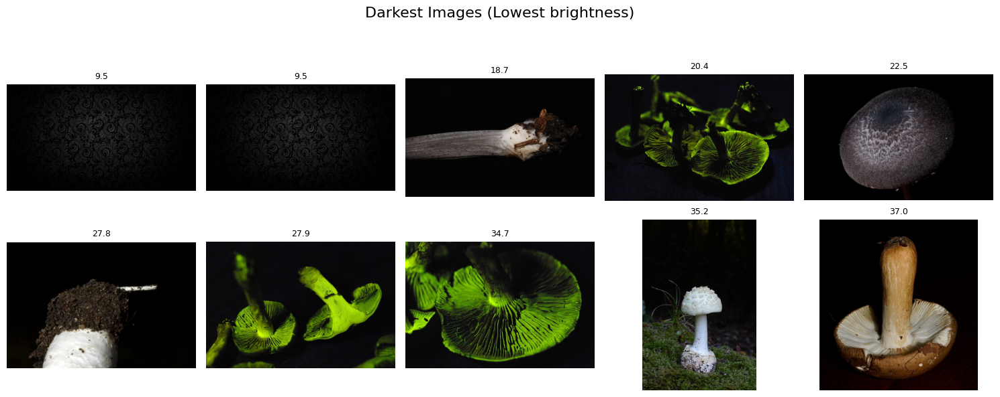

In [36]:
show_images_by_metric(mushrooms_df, "brightness", title="Darkest Images")


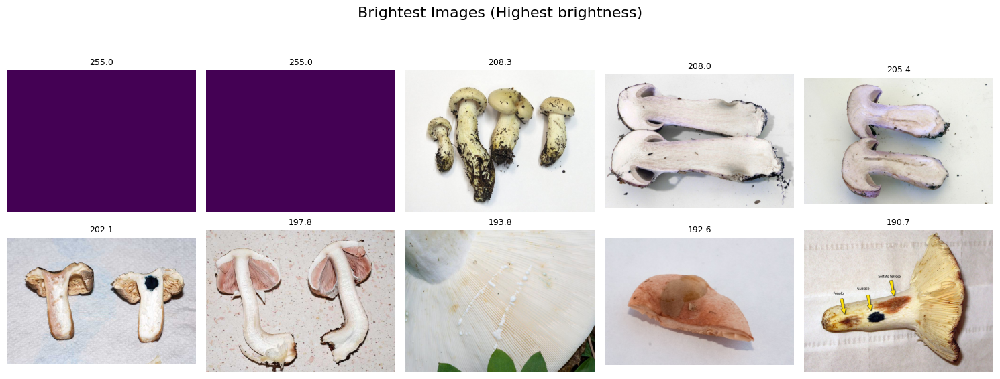

In [37]:
show_images_by_metric(mushrooms_df, "brightness", title="Brightest Images", mode="highest")

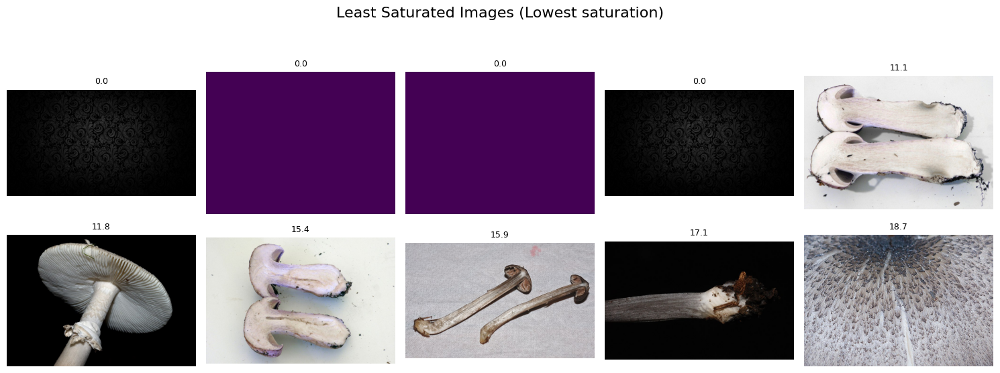

In [33]:
show_images_by_metric(mushrooms_df, "saturation", title="Least Saturated Images")

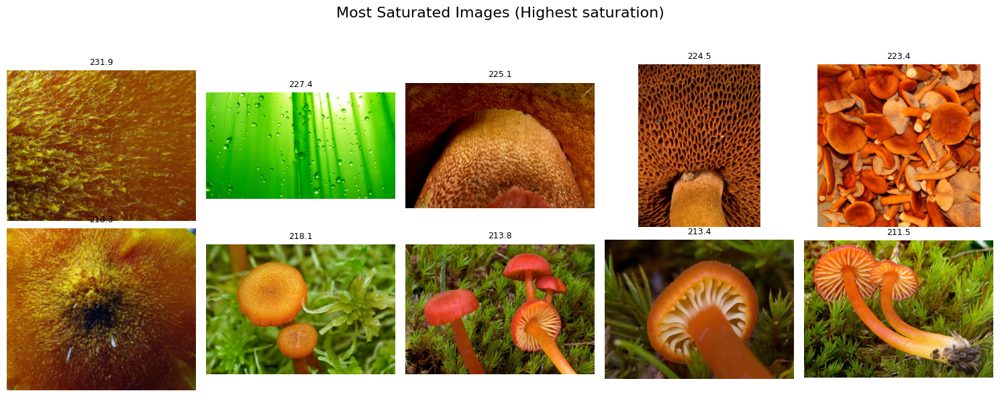

In [38]:
show_images_by_metric(mushrooms_df, "saturation", title="Most Saturated Images", mode="highest")

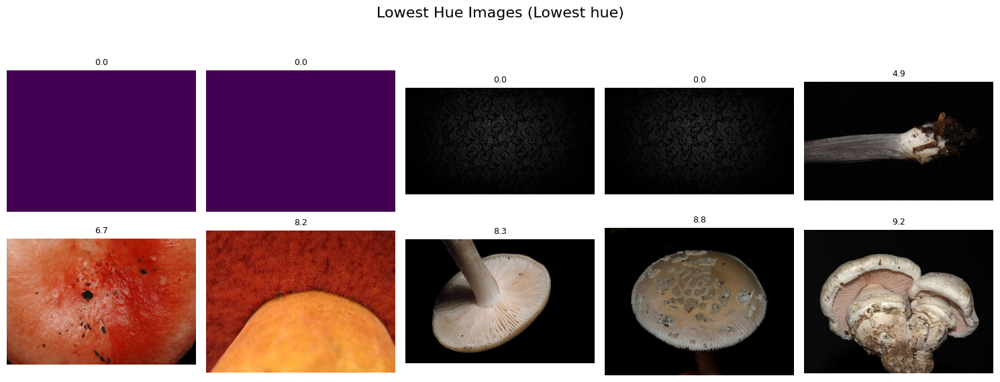

In [39]:
show_images_by_metric(mushrooms_df, "hue", title="Lowest Hue Images")

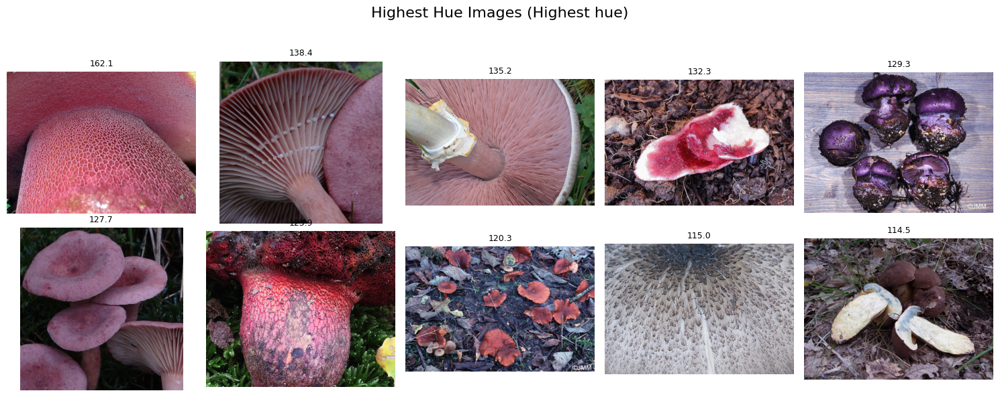

In [40]:
show_images_by_metric(mushrooms_df, "hue", title="Highest Hue Images", mode="highest")

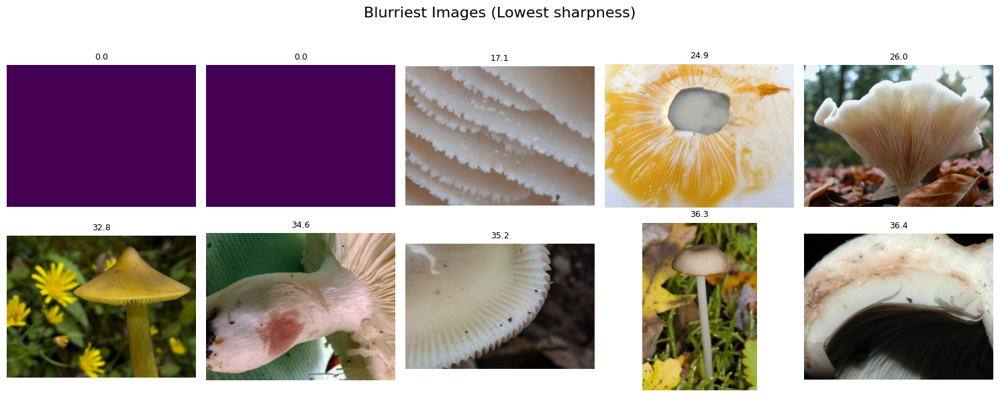

In [34]:
show_images_by_metric(mushrooms_df, "sharpness", title="Blurriest Images")

We see that a couple images are not even depicting mushrooms, so they will be removed, the other images at the extremes seem to feature some tinted pictures, that we should address with a black/white augmentation filter and some very zoomed pictures, we have to take this into consideration as well.

### ***Dataset Cleanup***

We will now remove images not displaying mushrooms or duplicates.

In [8]:
corrupted_path = f"{path}/mushrooms/Russula/092_43B354vYxm8.jpg"

before = len(mushrooms_df)

mushrooms_df = mushrooms_df[
    (mushrooms_df["sharpness"] > 0) &
    (mushrooms_df["hue"] > 0) &
    (~mushrooms_df["exact_duplicate"]) &
    (mushrooms_df["image_path"] != corrupted_path)
].reset_index(drop=True)

after = len(mushrooms_df)
print(f"Removed {before - after} images during cleanup.")
print(f"Remaining images: {after}")

Removed 141 images during cleanup.
Remaining images: 6576


## ***2. Baseline Model***

We will use a simple Logistic Regression model to see if it is able to correctly assign images to the proper class. We don't expect a good accuracy with this model.

### ***Dataset Split***

Since some of the classes have a fraction of the most represented one we will keep validation and test sets quite large at 20%.

In [9]:
train_val_df, test_df = train_test_split(
    mushrooms_df,
    test_size=0.2,
    stratify=mushrooms_df["class"],
    random_state=SEED
)

train_df, val_df = train_test_split(
    train_val_df,
    test_size=0.25,
    stratify=train_val_df["class"],
    random_state=SEED
)

### ***Basic transform for flattening***

No augmentation, resize and flatten

In [10]:
baseline_transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
])

def extract_flattened_features(df, transform):
    X = []
    y = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        try:
            img = Image.open(row["image_path"]).convert("RGB")
            img_tensor = transform(img) 
            X.append(img_tensor.flatten().numpy()) 
            y.append(row["class"])
        except Exception as e:
            print(f"Skipping image {row['image_path']}: {e}")
    return np.array(X), np.array(y)

### ***Extract features***

In [11]:
X_train, y_train = extract_flattened_features(train_df, baseline_transform)
X_val, y_val = extract_flattened_features(val_df, baseline_transform)
X_test, y_test = extract_flattened_features(test_df, baseline_transform)

100%|██████████| 1316/1316 [00:13<00:00, 97.73it/s] 


### ***Encode labels***

In [12]:
label_encoder = LabelEncoder()
y_train_enc = label_encoder.fit_transform(y_train)
y_val_enc = label_encoder.transform(y_val)
y_test_enc = label_encoder.transform(y_test)

### ***Train the logistic regression model***

In [ ]:
baseline_clf = LogisticRegression(
    max_iter=1000,
    solver='lbfgs'
)
baseline_clf.fit(X_train, y_train_enc);

### ***Model Evaluation***

In [ ]:
def evaluate_baseline(model, X, y_true, split_name="Validation"):
    y_pred = model.predict(X)
    acc = accuracy_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred, average="macro")
    print(f"\n{split_name} Accuracy: {acc:.4f}, Macro F1: {f1:.4f}")
    print(classification_report(y_true, y_pred, target_names=label_encoder.classes_))
    return acc, f1, y_pred

val_acc, val_f1, _ = evaluate_baseline(baseline_clf, X_val, y_val_enc, split_name="Validation")


🧪 Validation Accuracy: 0.2867, Macro F1: 0.2171
              precision    recall  f1-score   support

    Agaricus       0.13      0.11      0.12        71
     Amanita       0.27      0.29      0.28       150
     Boletus       0.36      0.39      0.38       214
 Cortinarius       0.23      0.18      0.20       167
    Entoloma       0.08      0.04      0.06        73
   Hygrocybe       0.21      0.10      0.13        63
   Lactarius       0.35      0.44      0.39       313
     Russula       0.24      0.29      0.26       229
     Suillus       0.22      0.10      0.13        63

    accuracy                           0.29      1343
   macro avg       0.23      0.22      0.22      1343
weighted avg       0.27      0.29      0.27      1343



In [13]:
test_acc, test_f1, test_preds = evaluate_baseline(baseline_clf, X_test, y_test_enc, split_name="Test")


🧪 Test Accuracy: 0.2448, Macro F1: 0.1888
              precision    recall  f1-score   support

    Agaricus       0.14      0.11      0.12        70
     Amanita       0.26      0.25      0.25       150
     Boletus       0.32      0.33      0.32       215
 Cortinarius       0.18      0.16      0.17       167
    Entoloma       0.04      0.03      0.03        73
   Hygrocybe       0.16      0.11      0.13        63
   Lactarius       0.32      0.38      0.35       313
     Russula       0.19      0.24      0.21       230
     Suillus       0.14      0.08      0.10        63

    accuracy                           0.24      1344
   macro avg       0.20      0.19      0.19      1344
weighted avg       0.23      0.24      0.24      1344



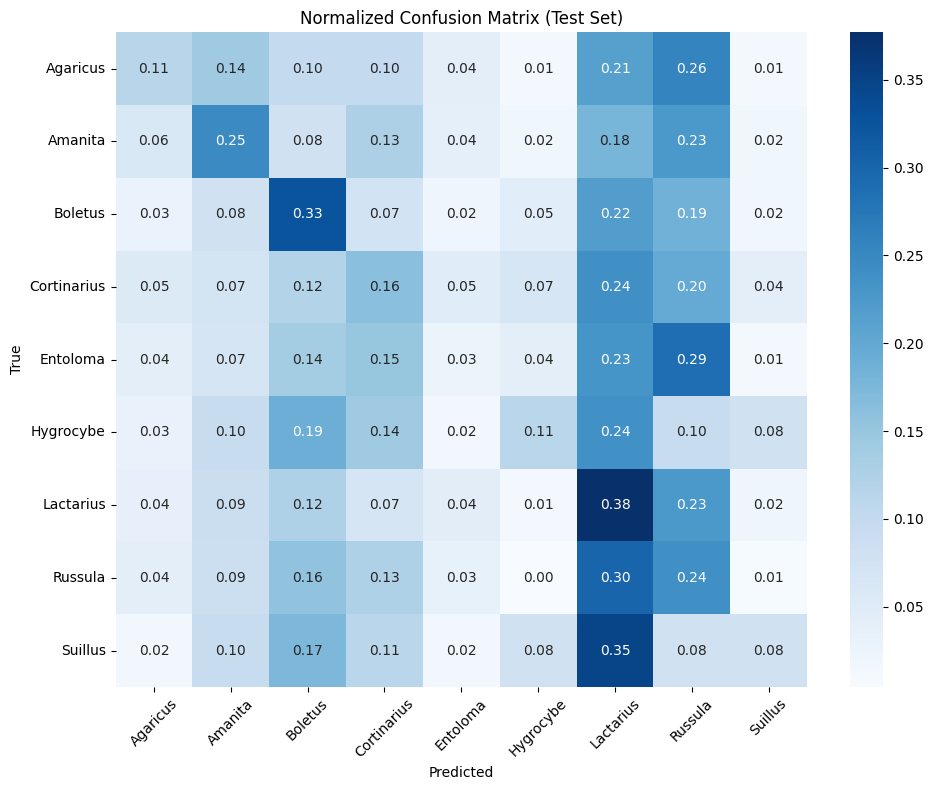

In [16]:
cm = confusion_matrix(y_test_enc, test_preds, normalize='true')

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_, fmt=".2f", cmap="Blues")
plt.title("Normalized Confusion Matrix (Test Set)")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


Both accuracy and macro F1 are quite low — which is expected from a logistic regression on flattened images. This performance confirms that the model is only capturing superficial differences in global color/brightness rather than meaningful spatial or structural patterns.

This baseline model demonstrates limited discriminative power across all classes, no class exceeds 40% correct classification and most true labels are heavily spread across multiple predicted classes.

## ***3. Deep Learning Model***

We will be using Pytorch Lightning with ResNet as a backbone. We expect the model to perform much better than the Logistic Regression.

### ***Transformation with Augmentation***

To improve the generalization ability of our model and simulate real-world variability in mushroom photography, we design our augmentation pipeline with the following considerations:

Random Rotation: Many mushrooms in the dataset are not consistently oriented. Some images show mushrooms horizontally aligned, while others appear rotated or even upside-down. Allowing large-angle random rotations helps the model learn rotational invariance and focus on morphological features rather than orientation.

Vertical Flip: A non-negligible portion of the dataset includes mushrooms viewed from unusual angles or mirrored vertically. Enabling vertical flipping introduces symmetry-based variation, which is particularly useful for biological subjects like mushrooms that are often radially or bilaterally symmetric.

Random Zoom (Crop + Resize): Some images in the dataset focus closely on parts of the mushroom (e.g., gills, stem texture), while others show them in full. By randomly cropping and resizing, we simulate zoom-in views and train the model to remain effective whether it sees the entire mushroom or just a part of it.

Desaturation (Random Grayscale Conversion): The dataset includes images with highly varied lighting and color balance — some overly vibrant, others nearly grayscale. To prevent over-reliance on color and emphasize shape and texture, we introduce random desaturation. This encourages the model to perform well even under poor or unnatural lighting conditions.

Color Jitter (Brightness, Contrast, Saturation): Natural variation in lighting and camera settings can shift the perceived color distribution. Applying mild random color jitter ensures robustness against such changes and simulates environmental conditions like shade, dusk, or artificial light.

These augmentations are applied only to the training set to synthetically expand the dataset and promote invariance to the types of distortions and variations likely to occur in real-world mushroom images captured on mobile devices.

In [15]:
class RandomDesaturate:
    def __init__(self, p=0.3):
        self.p = p

    def __call__(self, img):
        if random.random() < self.p:
            return transforms.functional.to_grayscale(img, num_output_channels=3)
        return img

train_transforms = transforms.Compose([
    transforms.Resize(224), 
    transforms.CenterCrop(224),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.2),
    transforms.RandomRotation(degrees=90),
    transforms.RandomResizedCrop(size=224, scale=(0.8, 1.0)),
    RandomDesaturate(p=0.3),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

val_test_transforms = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


### ***Dataset Definition***

In [16]:
class RobustImageDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        """
        Args:
            dataframe (pd.DataFrame): Cleaned DataFrame with at least 'image_path' and 'class' columns.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.df = dataframe.reset_index(drop=True)
        self.transform = transform

        self.class_names = sorted(self.df["class"].unique())
        self.class_to_idx = {name: idx for idx, name in enumerate(self.class_names)}
        self.image_paths = self.df["image_path"].tolist()
        self.labels = [self.class_to_idx[c] for c in self.df["class"]]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        label = self.labels[idx]
        try:
            image = Image.open(img_path).convert("RGB")
            if self.transform:
                image = self.transform(image)
            return image, label
        except Exception as e:
            print(f"Skipping problematic image: {img_path}, Error: {e}")
            return self.__getitem__((idx + 1) % len(self))

    @property
    def classes(self):
        """List of class names corresponding to integer labels."""
        return self.class_names


train_set = RobustImageDataset(dataframe=train_df, transform=train_transforms)
val_set   = RobustImageDataset(dataframe=val_df, transform=val_test_transforms)
test_set  = RobustImageDataset(dataframe=test_df, transform=val_test_transforms)

print(f"Train Size: {len(train_set)}, Val Size: {len(val_set)}, Test Size: {len(test_set)}")


Train Size: 3945, Val Size: 1315, Test Size: 1316


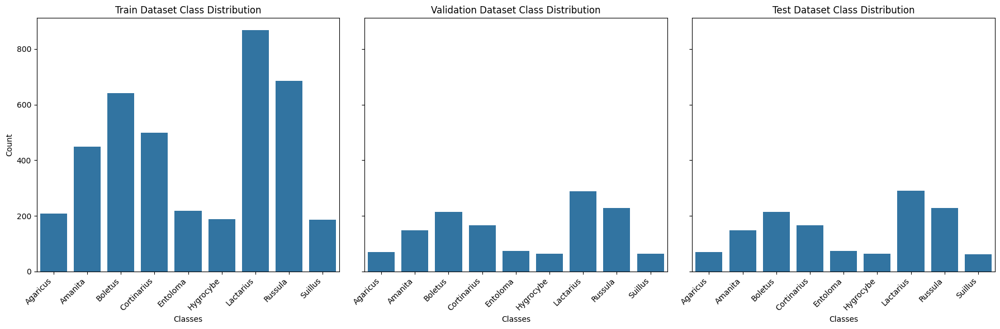

In [ ]:
def plot_distributions(train_set, val_set, test_set, classes):
    datasets = [train_set, val_set, test_set]
    titles = ["Train Dataset", "Validation Dataset", "Test Dataset"]

    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
    for i, (dataset, title) in enumerate(zip(datasets, titles)):
        label_list = [dataset[j][1] for j in range(len(dataset))]
        sns.countplot(x=label_list, order=range(len(classes)), ax=axes[i])
        axes[i].set_title(f"{title} Class Distribution")
        axes[i].set_xlabel("Classes")
        axes[i].set_ylabel("Count" if i == 0 else "")
        axes[i].set_xticks(range(len(classes)))
        axes[i].set_xticklabels(classes, rotation=45, ha="right")

    plt.tight_layout()
    plt.show()

plot_distributions(train_set, val_set, test_set, classes)

In [17]:
train_loader = DataLoader(train_set, batch_size=32, num_workers=0, pin_memory=True, shuffle=True)
val_loader = DataLoader(val_set, batch_size=32, num_workers=0)
test_loader = DataLoader(test_set, batch_size=32, num_workers=0)

print(f"Train dataset size: {len(train_set)}")
print(f"Validation dataset size: {len(val_set)}")
print(f"Test dataset size: {len(test_set)}")

Train dataset size: 3945
Validation dataset size: 1315
Test dataset size: 1316


### ***Model Definition***

We will be using weights in the loss function and replace the fully connected of ResNet-18 layer with a custom classifier. 
We will be initially freezing layers and then progressively unfreeze them with epochs, at the same time we will adjust learning rate.

In [20]:
class MushroomClassifier(pl.LightningModule):
    def __init__(self, num_classes, class_weights=None, lr=1e-3):
        super(MushroomClassifier, self).__init__()
        self.lr = lr
        self.num_classes = num_classes
        self.unfreeze_stage = 0

        self.backbone = resnet18(weights=ResNet18_Weights.DEFAULT)
        self.classifier_head = nn.Sequential(
            nn.Dropout(p=0.3), 
            nn.Linear(self.backbone.fc.in_features, num_classes)
        )
        self.backbone.fc = nn.Identity()
        for param in self.backbone.parameters():
            param.requires_grad = False

        self.train_accuracy = Accuracy(task="multiclass", num_classes=num_classes)
        self.val_accuracy = Accuracy(task="multiclass", num_classes=num_classes)
        self.test_accuracy = Accuracy(task="multiclass", num_classes=num_classes)
        self.classwise_accuracy = MulticlassAccuracy(num_classes=num_classes, average=None)

        self.train_f1 = F1Score(task="multiclass", num_classes=num_classes, average="macro")
        self.val_f1 = F1Score(task="multiclass", num_classes=num_classes, average="macro")
        self.test_f1 = F1Score(task="multiclass", num_classes=num_classes, average="macro")

        if class_weights is not None:
            self.criterion = nn.CrossEntropyLoss(weight=class_weights)
        else:
            self.criterion = nn.CrossEntropyLoss()

    def forward(self, x):
        features = self.backbone(x)
        return self.classifier_head(features)
    
    def training_step(self, batch, batch_idx):
        images, labels = batch
        outputs = self(images)
        loss = self.criterion(outputs, labels)

        acc = self.train_accuracy(outputs, labels)
        f1 = self.train_f1(outputs, labels)
        current_lr = self.trainer.optimizers[0].param_groups[0]["lr"]

        self.log("train_loss", loss, on_step=True, on_epoch=True, prog_bar=True)
        self.log("train_acc", acc, on_step=True, on_epoch=True, prog_bar=True)
        self.log("train_f1", f1, on_step=True, on_epoch=True, prog_bar=True)
        self.log("learning_rate", current_lr, on_step=True, on_epoch=True)

        return loss

    def validation_step(self, batch, batch_idx):
        images, labels = batch
        outputs = self(images)
        loss = self.criterion(outputs, labels)

        acc = self.val_accuracy(outputs, labels)
        f1 = self.val_f1(outputs, labels)
        classwise_acc = self.classwise_accuracy(outputs, labels)

        self.log("val_loss", loss, on_step=True, on_epoch=True, prog_bar=True)
        self.log("val_acc", acc, on_step=True, on_epoch=True, prog_bar=True)
        self.log("val_f1", f1, on_step=True, on_epoch=True, prog_bar=True)

        for i, a in enumerate(classwise_acc):
            self.log(f"class_{i}_acc", a, logger=True)

        return loss

    def test_step(self, batch, batch_idx):
        images, labels = batch
        outputs = self(images)
        loss = self.criterion(outputs, labels)
        acc = self.test_accuracy(outputs, labels)
        f1 = self.test_f1(outputs, labels)

        self.log("test_loss", loss, prog_bar=True)
        self.log("test_acc", acc, prog_bar=True)
        self.log("test_f1", f1, prog_bar=True)

        preds = torch.argmax(outputs, dim=1)
        return {"predictions": preds, "labels": labels, "loss": loss, "accuracy": acc}

    def on_train_epoch_start(self):
        """
        Gradually unfreeze layers based on current epoch and model stage.
        """
        self.epoch_start_time = time.time()

        if self.current_epoch >= 3 and self.unfreeze_stage == 0:
            for param in self.backbone.layer4.parameters():
                param.requires_grad = True
            self.unfreeze_stage = 1
            print("Unfroze layer4")

        elif self.current_epoch >= 6 and self.unfreeze_stage == 1:
            for param in self.backbone.layer3.parameters():
                param.requires_grad = True
            self.unfreeze_stage = 2
            print("Unfroze layer3")

        elif self.current_epoch >= 10 and self.unfreeze_stage == 2:
            for param in self.backbone.layer2.parameters():
                param.requires_grad = True
            self.unfreeze_stage = 3
            print("Unfroze layer2")

    def on_train_epoch_end(self):
        """
        Log the time taken for each epoch.
        """
        epoch_duration = time.time() - self.epoch_start_time
        self.log("epoch_duration", epoch_duration, prog_bar=True, logger=True)

    def on_after_backward(self):
        """
        Log gradient norms after backpropagation to monitor for exploding/vanishing gradients.
        """
        total_norm = 0
        for p in self.parameters():
            if p.grad is not None:
                param_norm = p.grad.data.norm(2)
                total_norm += param_norm.item() ** 2
        total_norm = total_norm ** 0.5
        self.log("grad_norm", total_norm, prog_bar=True, logger=True)

    def configure_optimizers(self):
        optimizer = Adam([
            {"params": self.classifier_head.parameters(), "lr": self.lr},
            {"params": self.backbone.parameters(), "lr": self.lr * 0.01}
        ], weight_decay=1e-4)

        scheduler = {
            "scheduler": ReduceLROnPlateau(optimizer, mode="min", factor=0.5, patience=2, verbose=True),
            "monitor": "val_loss",
            "interval": "epoch",
            "frequency": 1
        }

        return {"optimizer": optimizer, "lr_scheduler": scheduler}


### ***Class Weights Computation***

In [21]:
def compute_class_weights_from_df(df, label_column="class"):
    """
    Compute class weights based on inverse frequency from a pandas DataFrame.
    
    Args:
        df (pd.DataFrame): DataFrame containing class labels.
        label_column (str): Column name containing class labels.

    Returns:
        torch.Tensor: Normalized class weights as a float tensor.
    """
    class_counts = df[label_column].value_counts().sort_index()
    weights = 1.0 / class_counts
    weights = weights / weights.sum()
    return torch.tensor(weights.values, dtype=torch.float32)

class_weights = compute_class_weights_from_df(train_df)

num_classes = len(class_weights)

model = MushroomClassifier(num_classes=num_classes, class_weights=class_weights, lr=1e-4)

### ***Trainer Definition***

In [ ]:
logger = CSVLogger(save_dir="logs/", name="mushroom_classifier")

early_stopping = EarlyStopping(
    monitor="val_loss",
    patience=4,
    mode="min",
    verbose=True
)

checkpoint_callback = ModelCheckpoint(
    monitor="val_f1",
    mode="max",
    save_top_k=1,
    filename="best-model-{epoch:02d}-{val_f1:.3f}",
    auto_insert_metric_name=False
)

trainer = Trainer(
    max_epochs=30,
    accelerator="gpu" if torch.cuda.is_available() else "cpu",
    devices=1,
    num_sanity_val_steps=1, 
    enable_progress_bar=True, 
    limit_val_batches=2, 
    logger=logger, 
    gradient_clip_val=0.5,
    #log_every_n_steps=10,
    callbacks=[early_stopping, checkpoint_callback]
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [ ]:
trainer.fit(model, train_loader, val_loader)

In [ ]:
def measure_inference_time(model, data_loader, device):
    model.to(device) 
    model.eval()
    start_time = time.time()
    with torch.no_grad():
        for batch in data_loader:
            _ = model(batch[0].to(device))
    end_time = time.time()
    return end_time - start_time

# Use the correct device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

inference_time = measure_inference_time(model, val_loader, device)
print(f"Inference Time: {inference_time} seconds")


Inference Time: 17.789897441864014 seconds


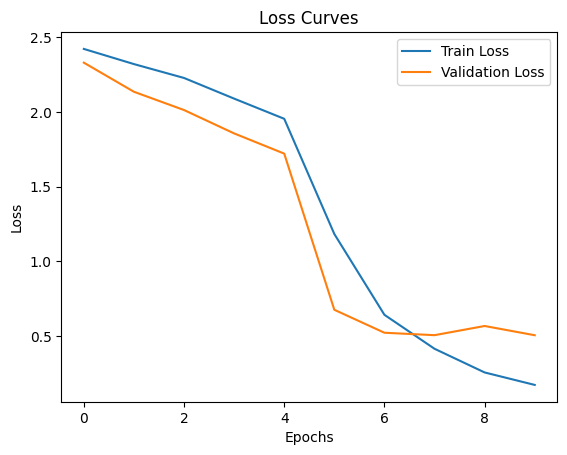

In [22]:
metrics_path = "logs/mushroom_classifier/version_10/metrics.csv"
metrics = pd.read_csv(metrics_path)

train_metrics = metrics[~metrics["train_loss_epoch"].isna()]
val_metrics = metrics[~metrics["val_loss_epoch"].isna()]

train_epochs = train_metrics["epoch"].values
train_loss = train_metrics["train_loss_epoch"].values

val_epochs = val_metrics["epoch"].values
val_loss = val_metrics["val_loss_epoch"].values

plt.plot(train_epochs, train_loss, label="Train Loss")
plt.plot(val_epochs, val_loss, label="Validation Loss")
plt.legend()
plt.title("Loss Curves")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.show()

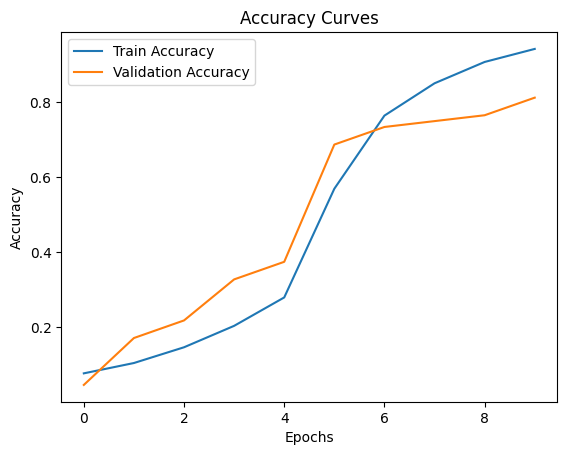

In [23]:
epoch_metrics = metrics.groupby("epoch").mean()

epochs = epoch_metrics.index
train_acc = epoch_metrics["train_acc_epoch"]
val_acc = epoch_metrics["val_acc_epoch"]

plt.plot(epochs, train_acc, label="Train Accuracy")
plt.plot(epochs, val_acc, label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Accuracy Curves")
plt.legend()
plt.show()

In [ ]:
train_f1 = epoch_metrics["train_f1_epoch"]
val_f1 = epoch_metrics["val_f1_epoch"]

plt.plot(epochs, train_f1, label="Train F1 Score")
plt.plot(epochs, val_f1, label="Validation F1 Score")
plt.xlabel("Epochs")
plt.ylabel("F1 Score")
plt.title("F1 Score Curves")
plt.legend()
plt.show()

Possible Overfitting:

The gap between training and validation accuracy in later epochs suggests that the model may be starting to overfit the training data.
Overfitting is likely because the training accuracy continues to increase, while validation accuracy stagnates.

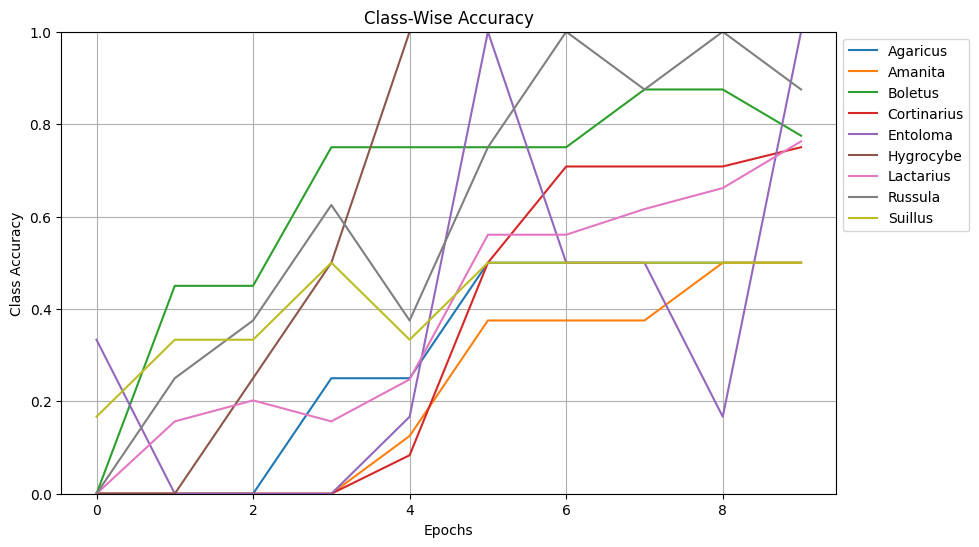

In [25]:
class_acc_columns = [col for col in metrics.columns if "class_" in col and "acc" in col]
cleaned_metrics = metrics.dropna(subset=["epoch"] + class_acc_columns)

plt.figure(figsize=(10, 6))
for col, class_name in zip(class_acc_columns, classes):
    plt.plot(cleaned_metrics["epoch"], cleaned_metrics[col], label=class_name)

plt.xlabel("Epochs")
plt.ylabel("Class Accuracy")
plt.ylim(0, 1.0) 
plt.title("Class-Wise Accuracy")
plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
plt.grid()
plt.show()

In [ ]:
cleaned_metrics = metrics.dropna(subset=["epoch", "learning_rate_epoch"])
plt.figure(figsize=(10, 6))
plt.plot(cleaned_metrics["epoch"], cleaned_metrics["learning_rate_epoch"], label="Learning Rate (Epoch)")
plt.xlabel("Epochs")
plt.ylabel("Learning Rate")
plt.title("Learning Rate Schedule")
plt.grid()
plt.legend()
plt.show()


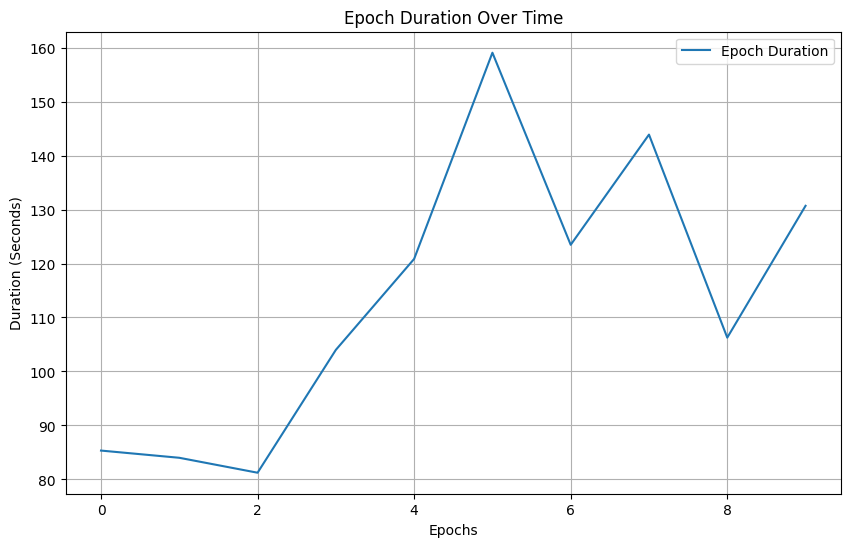

In [27]:
cleaned_metrics = metrics.dropna(subset=["epoch", "epoch_duration"])

plt.figure(figsize=(10, 6))
plt.plot(cleaned_metrics["epoch"], cleaned_metrics["epoch_duration"], label="Epoch Duration")
plt.xlabel("Epochs")
plt.ylabel("Duration (Seconds)")
plt.title("Epoch Duration Over Time")
plt.grid()
plt.legend()
plt.show()


In [87]:
trainer.test(model, dataloaders=test_loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\iceke\Documents\Data\Projects\mzanno-DL.1.5\.venv\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Testing DataLoader 0: 100%|██████████| 42/42 [01:27<00:00,  0.48it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test_acc            0.6466565132141113
         test_f1            0.5812358260154724
        test_loss           0.9004618525505066
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'test_loss': 0.9004618525505066,
  'test_acc': 0.6466565132141113,
  'test_f1': 0.5812358260154724}]

In [ ]:
def evaluate_model(model, test_loader, class_names):
    """
    Evaluate a trained model on a test DataLoader.
    
    Args:
        model: trained PyTorch model (LightningModule or nn.Module)
        test_loader: DataLoader for the test set
        class_names: list of class names (for labeling the confusion matrix)
    """
    device = next(model.parameters()).device
    model.eval()
    model.to(device)

    predictions, y_true = [], []

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            probs = F.softmax(outputs, dim=1)
            preds = torch.argmax(probs, dim=1)
            predictions.append(preds)
            y_true.append(labels)

    predictions = torch.cat(predictions).cpu()
    y_true = torch.cat(y_true).cpu()

    print(classification_report(y_true, predictions, target_names=class_names))

    # Confusion Matrix
    conf_mat = confusion_matrix(y_true, predictions, normalize='true')
    plt.figure(figsize=(10, 8))
    sns.heatmap(conf_mat, annot=True, fmt=".2f", xticklabels=class_names, yticklabels=class_names, cmap="Blues")
    plt.title("Normalized Confusion Matrix")
    plt.ylabel("True Label")
    plt.xlabel("Predicted Label")
    plt.tight_layout()
    plt.show()

              precision    recall  f1-score   support

    Agaricus       0.39      0.70      0.50        70
     Amanita       0.76      0.62      0.68       149
     Boletus       0.86      0.88      0.87       214
 Cortinarius       0.62      0.55      0.58       166
    Entoloma       0.48      0.67      0.56        73
   Hygrocybe       0.55      0.89      0.68        63
   Lactarius       0.75      0.48      0.59       290
     Russula       0.76      0.60      0.67       229
     Suillus       0.37      0.77      0.50        62

    accuracy                           0.65      1316
   macro avg       0.61      0.69      0.63      1316
weighted avg       0.69      0.65      0.65      1316



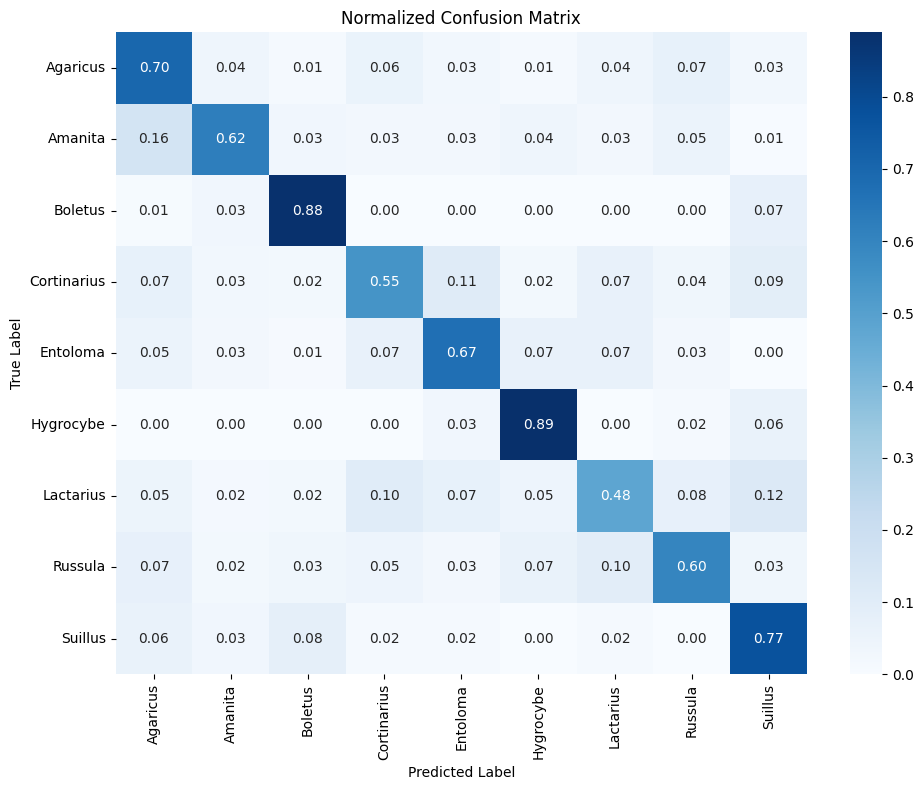

In [89]:
evaluate_model(model, test_loader, class_names=train_set.classes)

## ***Conclusion***

This project demonstrates the workflow for classifying mushroom images using transfer learning and fine-tuning. The overall accuracy is not bad considering the simple approach used. However, there is room for improvement:

- Addressing class imbalance with synthetic data or more advanced weighting techniques.
- Exploring larger pre-trained models for better accuracy.
- Investigating different fine-tuning strategies.
- Incrementing the initial dataset.